Training the PINN to learn u(τ) (and hence r(t)=exp(u(τ)))...
Epoch: 0, Loss: 9.73505e-01, lambda: 0.000
Diagnostics for sample τ values:
τ: [0.72036016 0.13056529 0.36168084 0.96948475 0.45322663 0.38669336
 0.1915958  0.46173087 0.75687844 0.47773886]
u: [4.338792  4.372326  4.3579454 4.3286686 4.352612  4.3564625 4.368437
 4.3521304 4.337133  4.35123  ]
r: [76.61492  79.22769  78.09651  75.84324  77.6811   77.98079  78.920166
 77.6437   76.48793  77.57383 ]
du/dτ: [-0.04623395 -0.06405111 -0.05964031 -0.03496498 -0.05679238 -0.05891373
 -0.06333936 -0.05650298 -0.04462221 -0.05594782]
dr/dt: [-0.00354221 -0.00507462 -0.0046577  -0.00265186 -0.00441169 -0.00459414
 -0.00499875 -0.0043871  -0.00341306 -0.00434009]
flux(r): [6.4441953 5.092649  5.6335664 6.91871   5.848462  5.692511  5.233596
 5.868264  6.519668  5.9054656]
dE/dr: [1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08 1.e-08]
Residual: [6.4441952e+08 5.0926490e+08 5.6335667e+08 6.9187104e+08 5.8484621e+08
 5.6

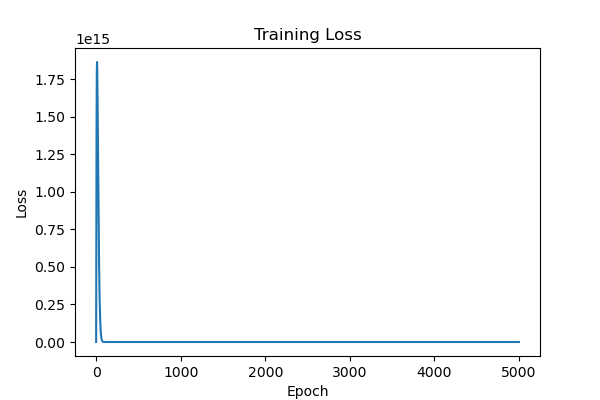

Animation size has reached 21001583 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


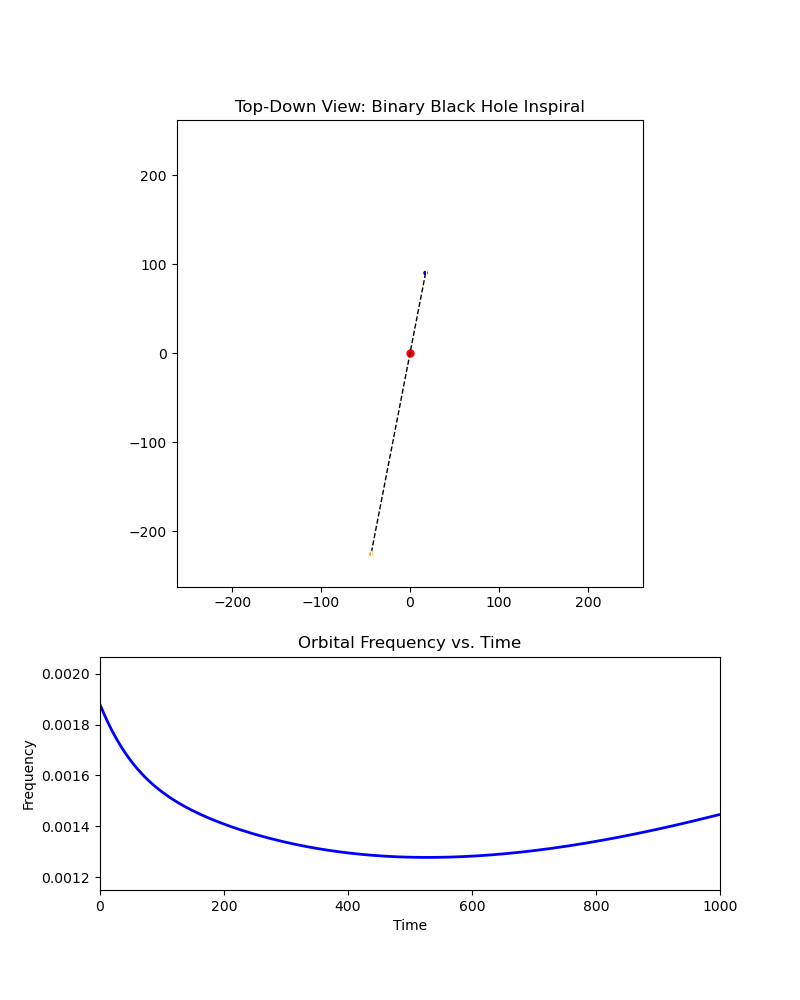

In [42]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import time
from IPython.display import HTML, display
from matplotlib.patches import Circle

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


###############################################################################
# PHYSICAL FUNCTIONS (G=c=1)

# Component masses of BBH
m1 = 50.0  
m2 = 20.0
m = m1 + m2    
mu = m1 * m2 / m 
eta = (m1 * m2) / (m * m)  # symmetric mass ratio

# 2PN circular-orbit energy (Schäfer & Wex) if you find the equations here are not accurate, please revise here
a = (9.0 + eta) / 12.0
b = (27.0 - 19.0 * eta + eta * eta) / 8.0

def energy(r):
    return - (mu / 2.0) * (m / r) * (1 - a * (m / r) - b * (m / r)**2)

def flux(r):
    x = m / r
    term1 = 1.0
    term2 = - x * (2927.0 / 336.0 + (5.0/4.0)*eta)
    term3 = 4 * np.pi * torch.pow(x, 1.5)
    term4 = torch.pow(x, 2) * (293383.0 / 9072.0 + (380.0/9.0)*eta)
    return (32.0/5.0) * (eta**2) * torch.pow(x, 5) * (term1 + term2 + term3 + term4)

def dE_dr(r):
    r_leaf = r.clone().detach().requires_grad_(True)
    E = energy(r_leaf)
    dE = torch.autograd.grad(E, r_leaf, grad_outputs=torch.ones_like(E), create_graph=True)[0]
    return torch.clamp(dE, min=1e-8)

###############################################################################
# PINN
# Simulation time scale
T_scale = 1000.0 

# The network learns u(τ) = log[r(t)], so that r(t)=exp(u(τ)).
class PINN(nn.Module):
    def __init__(self, hidden_layers=4, neurons=50):
        super(PINN, self).__init__()
        layers = []
        layers.append(nn.Linear(1, neurons))
        layers.append(nn.Tanh())
        for _ in range(hidden_layers - 1):
            layers.append(nn.Linear(neurons, neurons))
            layers.append(nn.Tanh())
        self.final_layer = nn.Linear(neurons, 1)
        layers.append(self.final_layer)
        self.net = nn.Sequential(*layers)
        # Initialize final layer bias to approximately log(r0) where r0 will be set below.
        self.final_layer.bias.data.fill_(np.log(80))  # adjust here when r0 is changed
    def forward(self, tau):
        return self.net(tau)

def model_derivative(model, tau):
    tau_leaf = tau.clone().detach().requires_grad_(True)
    u_pred = model(tau_leaf)
    grad_outputs = torch.ones_like(u_pred).to(device)
    du_dtau = torch.autograd.grad(outputs=u_pred, inputs=tau_leaf,
                                  grad_outputs=grad_outputs,
                                  create_graph=True)[0]
    return du_dtau

def pinn_loss(model, tau_colloc):
    u_pred = model(tau_colloc)
    r_pred = torch.exp(u_pred)
    du_dtau = model_derivative(model, tau_colloc)
    dr_dt = (1.0/T_scale) * r_pred * du_dtau
    dE_dr_val = dE_dr(r_pred)
    residual = dr_dt + flux(r_pred) / dE_dr_val
    return torch.mean(residual**2)


def ic_loss(model, tau0, u0):
    u0_pred = model(tau0)
    return torch.mean((u0_pred - u0)**2)

def total_loss(model, tau_colloc, tau0, u0, lam):
    return ic_loss(model, tau0, u0) + lam * pinn_loss(model, tau_colloc)

###############################################################################
# DEBUGGING UTILITIES
def debug_diagnostics(model, tau_sample):
    tau_sample_leaf = tau_sample.clone().detach().requires_grad_(True)
    u_sample = model(tau_sample_leaf)
    r_sample = torch.exp(u_sample)
    du_sample = model_derivative(model, tau_sample_leaf)
    dr_sample = (1.0/T_scale) * r_sample * du_sample
    Egrad_sample = dE_dr(r_sample)
    flux_sample = flux(r_sample)
    residual_sample = dr_sample + flux_sample / Egrad_sample
    print("Diagnostics for sample τ values:")
    print("τ:", tau_sample_leaf.squeeze().detach().cpu().numpy())
    print("u:", u_sample.squeeze().detach().cpu().numpy())
    print("r:", r_sample.squeeze().detach().cpu().numpy())
    print("du/dτ:", du_sample.squeeze().detach().cpu().numpy())
    print("dr/dt:", dr_sample.squeeze().detach().cpu().numpy())
    print("flux(r):", flux_sample.squeeze().detach().cpu().numpy())
    print("dE/dr:", Egrad_sample.squeeze().detach().cpu().numpy())
    print("Residual:", residual_sample.squeeze().detach().cpu().numpy())
    for var_name, var in [("u", u_sample), ("r", r_sample), ("du/dτ", du_sample),
                          ("dr/dt", dr_sample), ("flux", flux_sample),
                          ("dE/dr", Egrad_sample), ("Residual", residual_sample)]:
        if not torch.all(torch.isfinite(var)):
            print(f"Warning: {var_name} contains non-finite values.")

###############################################################################
# TRAINING AND ANIMATION ROUTINES

def train_pinn(model, optimizer, tau_colloc, tau0, u0, epochs=5000, warmup_epochs=1000):
    model.train()
    loss_history = []
    start_time = time.time()
    for epoch in range(epochs):
        optimizer.zero_grad()
        lam = min(epoch / warmup_epochs, 1.0)
        loss = total_loss(model, tau_colloc, tau0, u0, lam)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()
        loss_history.append(loss.item())
        if epoch % 500 == 0:
            sample_indices = torch.randint(0, tau_colloc.shape[0], (10,), device=device)
            tau_sample = tau_colloc[sample_indices]
            print(f"Epoch: {epoch}, Loss: {loss.item():.5e}, lambda: {lam:.3f}")
            debug_diagnostics(model, tau_sample)
    print(f"Training completed in {time.time() - start_time:.2f} seconds.")
    return loss_history

# Animation for orbital separation vs. time.
def animate_separation(t_vals, r_vals):
    fig, ax = plt.subplots(figsize=(8, 5))
    ax.set_xlim(t_vals[0], t_vals[-1])
    ax.set_ylim(np.min(r_vals)*0.9, np.max(r_vals)*1.1)
    ax.set_xlabel('Time t')
    ax.set_ylabel('Separation r(t)')
    ax.set_title('Orbital Separation vs. Time')
    line, = ax.plot([], [], 'b-', lw=2)
    
    def init():
        line.set_data([], [])
        return (line,)
    
    def update(frame):
        line.set_data(t_vals[:frame], r_vals[:frame])
        return (line,)
    
    ani = animation.FuncAnimation(fig, update, frames=len(t_vals),
                                  init_func=init, interval=30, blit=True)
    return ani


def animate_blackholes_topdown_with_labels_reverse_time(t_vals, r_vals, m1, m2):
    """
    Animate a top-down view of binary black holes in the center-of-mass frame,
    with masses m1 and m2. The animation runs from final time to initial time
    (so that we see 'remaining time' decreasing).
    
    Features:
      - BH sizes proportional to mass^(1/3).
      - BHs labeled with 'm1' and 'm2'.
      - Red dot at center-of-mass (origin).
      - Time readout (remaining time) updates each frame.
    """
    import matplotlib.pyplot as plt
    from matplotlib.patches import Circle
    from matplotlib import animation
    
    fig, ax = plt.subplots(figsize=(6,6))
    
    # 1) Compute the orbital phase array from a simple Keplerian frequency.
    #    We'll do forward in time, then reverse the frames in the animation.
    
    total_mass = m1 + m2
    dt = np.diff(t_vals)
    # Use midpoints for an approximate r(t):
    r_mid = 0.5*(r_vals[:-1] + r_vals[1:])
    # Avoid dividing by zero if r_mid is small.
    omega_inst = np.sqrt(total_mass / (r_mid**3))
    # Integrate to get phase forward in time:
    phi_forward = np.concatenate(([0], np.cumsum(omega_inst * dt)))
    
    # 2) Setup axis limits: we find the maximum radius to set an appropriate limit.
    max_r = np.max(r_vals)
    lim = 1.5 * max_r   # adjust as needed
    ax.set_xlim(-lim, lim)
    ax.set_ylim(-lim, lim)
    ax.set_aspect('equal', 'box')
    
    # 3) Title, center-of-mass dot, etc.
    ax.set_title("Top-Down View: Spiral with Time Running Backwards")
    center_dot, = ax.plot(0, 0, 'ro', markersize=5)  # red dot at CoM
    
    # 4) Create circles for the BHs, sized by mass^(1/3).
    #    In the center-of-mass frame:
    #      BH1: (x1,y1) = ( (m2)/(m1+m2)*r*cos(phi),  (m2)/(m1+m2)*r*sin(phi) )
    #      BH2: (x2,y2) = (-(m1)/(m1+m2)*r*cos(phi), -(m1)/(m1+m2)*r*sin(phi) )
    
    scale = 0.1  # can adjust if you want bigger or smaller spheres
    radius1 = scale*(m1**(1/3))
    radius2 = scale*(m2**(1/3))
    
    # Initialize them at final time's position:
    i_final = len(t_vals) - 1
    r_fin = r_vals[i_final]
    phi_fin = phi_forward[i_final]
    x1_fin = (m2/total_mass)*r_fin*np.cos(phi_fin)
    y1_fin = (m2/total_mass)*r_fin*np.sin(phi_fin)
    x2_fin = -(m1/total_mass)*r_fin*np.cos(phi_fin)
    y2_fin = -(m1/total_mass)*r_fin*np.sin(phi_fin)
    
    bh1 = Circle((x1_fin, y1_fin), radius=radius1, color='blue')
    bh2 = Circle((x2_fin, y2_fin), radius=radius2, color='orange')
    ax.add_patch(bh1)
    ax.add_patch(bh2)
    
    # 5) Label text for each BH:
    txt1 = ax.text(x1_fin, y1_fin, "m1", color='white', ha='center', va='center')
    txt2 = ax.text(x2_fin, y2_fin, "m2", color='white', ha='center', va='center')
    
    # 6) Connect them with a line:
    line, = ax.plot([x1_fin, x2_fin], [y1_fin, y2_fin], 'r--', lw=1)
    
    # 7) Also display a text for "Remaining time"
    time_text = ax.text(0.02, 0.95, "", transform=ax.transAxes,
                        color='black', fontsize=10, va='top')
    
    # init function for FuncAnimation:
    def init():
        bh1.center = (x1_fin, y1_fin)
        bh2.center = (x2_fin, y2_fin)
        txt1.set_position((x1_fin, y1_fin))
        txt2.set_position((x2_fin, y2_fin))
        line.set_data([x1_fin, x2_fin], [y1_fin, y2_fin])
        time_rem = t_vals[i_final] - t_vals[i_final]  # 0 at final
        time_text.set_text(f"Remaining time: {time_rem:.2f}")
        return bh1, bh2, line, center_dot, txt1, txt2, time_text
    
    # update function: we'll iterate frames from last to first
    # so "frame" goes 0..(len(t_vals)-1) => i = len(t_vals) - 1 - frame
    def update(frame):
        i = len(t_vals) - 1 - frame
        r_now = r_vals[i]
        phi_now = phi_forward[i]
        # BH1
        x1 = (m2/total_mass)*r_now*np.cos(phi_now)
        y1 = (m2/total_mass)*r_now*np.sin(phi_now)
        # BH2
        x2 = -(m1/total_mass)*r_now*np.cos(phi_now)
        y2 = -(m1/total_mass)*r_now*np.sin(phi_now)
        
        bh1.center = (x1, y1)
        bh2.center = (x2, y2)
        txt1.set_position((x1, y1))
        txt2.set_position((x2, y2))
        
        line.set_data([x1, x2], [y1, y2])
        
        # "Remaining time"
        time_rem = t_vals[-1] - t_vals[i]
        time_text.set_text(f"Remaining time: {time_rem:.2f}")
        
        return bh1, bh2, line, center_dot, txt1, txt2, time_text
    
    ani = animation.FuncAnimation(fig, update,
                                  frames=len(t_vals),
                                  init_func=init,
                                  interval=30, blit=True)
    return ani
def animate_inspiral_with_frequency(t_vals, r_vals, m1, m2, alpha=1):
    """
    Create an animation showing:
      (1) A top-down view of a binary black hole inspiral in the center-of-mass frame.
          - Black holes are drawn as circles whose sizes scale as m^(1/3) and are labeled ("m1" and "m2").
          - A red dot marks the center-of-mass.
      (2) An orbital frequency vs. time plot.
    
    The orbital phase is computed by integrating the instantaneous Keplerian frequency,
    where ω(t) ≃ sqrt((m1+m2)/r(t)³). The parameter 'alpha' multiplies the frequency; set
    alpha=1 for physical behavior, or alpha>1 to exaggerate the revolutions visually.
    
    Parameters:
      t_vals : 1D NumPy array of physical times (in your chosen units).
      r_vals : 1D NumPy array of orbital separations corresponding to t_vals.
      m1, m2 : The masses of the two black holes.
      alpha  : Frequency boost factor (default 1).
    
    Returns:
      ani    : A Matplotlib FuncAnimation object.
    """
    import numpy as np
    import matplotlib.pyplot as plt
    from matplotlib.patches import Circle
    from matplotlib import animation
    from IPython.display import HTML

    total_mass = m1 + m2
    # Compute dt from t_vals:
    dt = np.diff(t_vals)
    # For frequency computation, use midpoints of r:
    r_mid = 0.5 * (r_vals[:-1] + r_vals[1:])
    # Instantaneous orbital frequency (Keplerian approximate):
    freq_inst = alpha * np.sqrt(total_mass / (r_mid**3))
    # Integrate to get the orbital phase:
    phi = np.concatenate(([0], np.cumsum(freq_inst * dt)))
    # For the frequency vs. time plot, extend freq_inst to full length:
    freq_of_t = np.concatenate((freq_inst, [freq_inst[-1]]))
    
    # Setup figure with two subplots: upper for BH schematic, lower for frequency plot.
    fig = plt.figure(figsize=(8, 10))
    gs = fig.add_gridspec(2, 1, height_ratios=[2, 1])
    ax_bh = fig.add_subplot(gs[0, 0])
    ax_freq = fig.add_subplot(gs[1, 0])
    
    # --- Top panel: BH schematic
    # Set axis limits based on the maximum separation.
    max_r = np.max(r_vals)
    lim = 1.5 * max_r / 2.0
    ax_bh.set_xlim(-lim, lim)
    ax_bh.set_ylim(-lim, lim)
    ax_bh.set_aspect("equal", "box")
    ax_bh.set_title("Top-Down View: Binary Black Hole Inspiral")
    
    # Mark the center-of-mass.
    center_dot, = ax_bh.plot(0, 0, 'ro', markersize=5)
    
    # Set BH sizes: scale the radius proportional to the cube-root of the mass.
    scale = 0.5   # Adjust for visual size.
    radius1 = scale * (m1 ** (1/3))
    radius2 = scale * (m2 ** (1/3))
    
    # Initial positions from t_vals[0] and phi[0]:
    x1_0 = (m2/total_mass) * r_vals[0] * np.cos(phi[0])
    y1_0 = (m2/total_mass) * r_vals[0] * np.sin(phi[0])
    x2_0 = -(m1/total_mass) * r_vals[0] * np.cos(phi[0])
    y2_0 = -(m1/total_mass) * r_vals[0] * np.sin(phi[0])
    
    bh1 = Circle((x1_0, y1_0), radius=radius1, color='blue')
    bh2 = Circle((x2_0, y2_0), radius=radius2, color='orange')
    ax_bh.add_patch(bh1)
    ax_bh.add_patch(bh2)
    
    # Labels for each BH.
    label1 = ax_bh.text(x1_0, y1_0, "m1", color='white', ha='center', va='center')
    label2 = ax_bh.text(x2_0, y2_0, "m2", color='white', ha='center', va='center')
    
    # Connector line between BHs.
    line_conn, = ax_bh.plot([x1_0, x2_0], [y1_0, y2_0], 'k--', lw=1)
    
    # --- Bottom panel: Frequency vs. time
    ax_freq.set_xlim(t_vals[0], t_vals[-1])
    f_min, f_max = np.min(freq_of_t), np.max(freq_of_t)
    ax_freq.set_ylim(0.9*f_min, 1.1*f_max)
    ax_freq.set_xlabel("Time")
    ax_freq.set_ylabel("Frequency")
    ax_freq.set_title("Orbital Frequency vs. Time")
    freq_line, = ax_freq.plot([], [], 'b-', lw=2)
    freq_xdata, freq_ydata = [], []
    
    # --- Initialization function.
    def init():
        bh1.center = (x1_0, y1_0)
        label1.set_position((x1_0, y1_0))
        bh2.center = (x2_0, y2_0)
        label2.set_position((x2_0, y2_0))
        line_conn.set_data([x1_0, x2_0], [y1_0, y2_0])
        freq_line.set_data([], [])
        return bh1, bh2, line_conn, label1, label2, center_dot, freq_line
    
    # --- Update function.
    def update(frame):
        # Use current frame index 'frame' to update positions.
        r_now = r_vals[frame]
        phi_now = phi[frame]
        # Compute BH positions in the center-of-mass frame.
        x1 = (m2/total_mass) * r_now * np.cos(phi_now)
        y1 = (m2/total_mass) * r_now * np.sin(phi_now)
        x2 = -(m1/total_mass) * r_now * np.cos(phi_now)
        y2 = -(m1/total_mass) * r_now * np.sin(phi_now)
        bh1.center = (x1, y1)
        label1.set_position((x1, y1))
        bh2.center = (x2, y2)
        label2.set_position((x2, y2))
        line_conn.set_data([x1, x2], [y1, y2])
        # Update frequency plot.
        freq_xdata.append(t_vals[frame])
        freq_ydata.append(freq_of_t[frame])
        freq_line.set_data(freq_xdata, freq_ydata)
        return bh1, bh2, line_conn, label1, label2, center_dot, freq_line
    
    ani = animation.FuncAnimation(fig, update, frames=len(t_vals),
                                  init_func=init, interval=30, blit=True)
    return ani



def main():
    # Normalized time domain: τ from 0 to 1 (physical time t = T_scale * τ).
    tau0_val = 0.0
    tau_final_val = 1.0
    num_colloc = 2000
    tau_colloc_np = np.linspace(tau0_val, tau_final_val, num_colloc).reshape(-1, 1)
    tau_colloc = torch.tensor(tau_colloc_np, dtype=torch.float32, device=device, requires_grad=True)
    
    # Set initial separation r0
    r0_val = 30.0
    u0_val = np.log(r0_val)
    tau0_tensor = torch.tensor([[tau0_val]], dtype=torch.float32, device=device, requires_grad=True)
    u0_tensor = torch.tensor([[u0_val]], dtype=torch.float32, device=device)
    
    model = PINN(hidden_layers=4, neurons=50).to(device)
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    print("Training the PINN to learn u(τ) (and hence r(t)=exp(u(τ)))...")
    loss_history = train_pinn(model, optimizer, tau_colloc, tau0_tensor, u0_tensor,
                              epochs=5000, warmup_epochs=1000)
    
    model.eval()

    with torch.no_grad():
        tau_test = torch.linspace(0, 1, 500).view(-1, 1).to(device)
        u_pred = model(tau_test)
        r_pred = torch.exp(u_pred)
        
    # Convert normalized time τ to physical time t:
    t_vals = tau_test.cpu().numpy().flatten() * T_scale  
    r_vals = r_pred.cpu().numpy().flatten()
        
    plt.figure(figsize=(6,4))
    plt.plot(loss_history)
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.title("Training Loss")
    plt.show()

    ani = animate_inspiral_with_frequency(t_vals, r_vals, m1, m2)

    display(HTML(ani.to_jshtml()))

if __name__ == '__main__':
    main()
